In [14]:
import librosa
import librosa.display
import IPython.display as ipd
import matplotlib.pyplot as plt
import numpy as np

In [46]:
kratzerPath = "audio/Einzelbeispiele/88003-Kratzer-Knackser-MFM062-A1-29311.wav"
pickelPath = "audio/Einzelbeispiele/88000-Pickel-SOV021-A1-28190.wav"
auspressfehlerPath = "audio/Einzelbeispiele/88002-periodischesschleifen-5511001-A2-29504.wav"


In [47]:
ipd.Audio(kratzerPath)


In [49]:
ipd.Audio(pickelPath)

In [50]:
ipd.Audio(auspressfehlerPath)

In [48]:
kratzer, sr = librosa.load(kratzerPath, sr=22050, mono=True)
pickel, _ = librosa.load(pickelPath, sr=22050, mono=True)
auspressfehler, _ = librosa.load(auspressfehlerPath, sr=22050, mono=True)

print(sr)
kratzer.size

22050


1093120

In [38]:
sample_duration = 1 / sr
print(f"Duration of 1 sample is: {sample_duration:.6f}seconds")
duration = sample_duration * len(kratzer)
print(f"Duration of signal is: {duration:.2f} seconds")

Duration of 1 sample is: 0.000045seconds


(-1.0, 1.0)

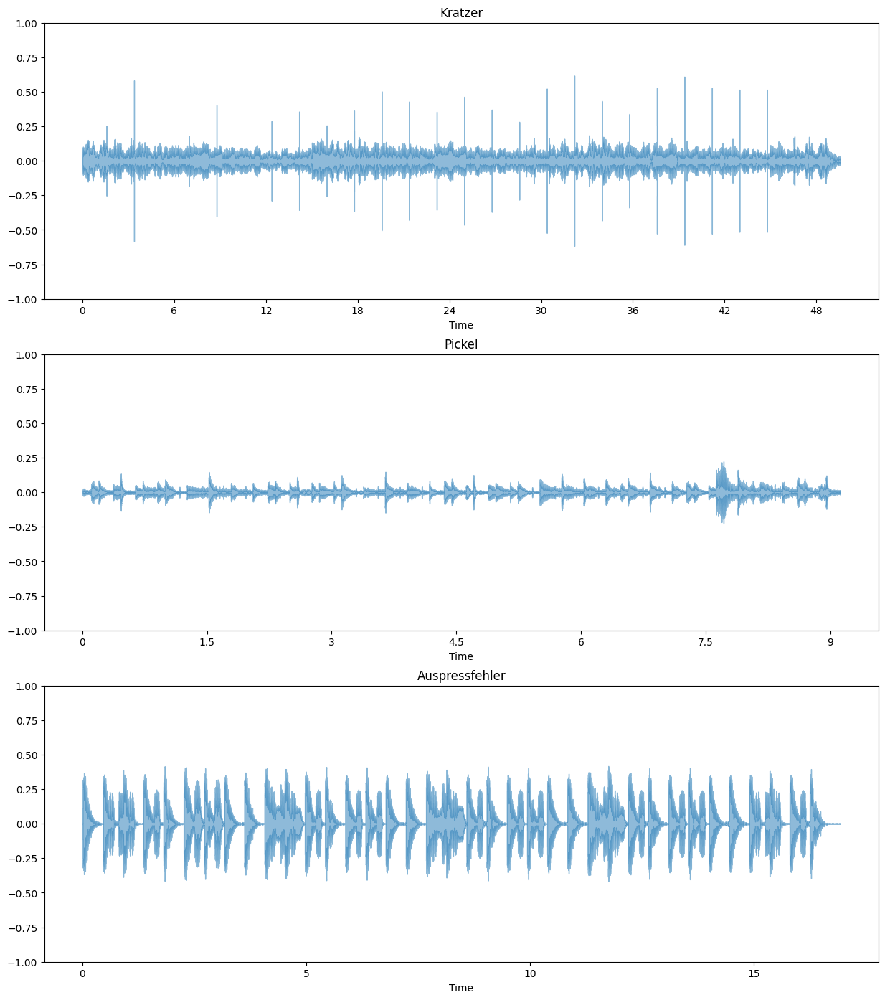

In [49]:
plt.figure(figsize=(15, 17))

plt.subplot(3, 1, 1)
librosa.display.waveshow(kratzer, alpha=0.5)
plt.title("Kratzer")
plt.ylim(-1, 1)

plt.subplot(3, 1, 2)
librosa.display.waveshow(pickel, alpha=0.5)
plt.title("Pickel")
plt.ylim(-1, 1)

plt.subplot(3, 1, 3)
librosa.display.waveshow(auspressfehler, alpha=0.5)
plt.title("Auspressfehler")
plt.ylim(-1, 1)



In [65]:
FRAME_SIZE = 1024
HOP_LENGTH = 512

#  calculate the amplitude envelope
def amplitude_envelope(signal, frame_size, hop_length):
    amplitude_envelope = []

    #  calculate AE for each frame
    for i in range(0, len(signal), hop_length):
        current_frame_amplitude_envelope = max(signal[i:i+frame_size])
        amplitude_envelope.append(current_frame_amplitude_envelope)

    return np.array(amplitude_envelope)



def amplitude_envelope2(signal, frame_size, hop_length):
    return np.array([max(signal[i:i+frame_size]) for i in range(0, signal.size, hop_length)])

In [66]:
ae_kratzer= amplitude_envelope2(kratzer, FRAME_SIZE, HOP_LENGTH)
ae_pickel = amplitude_envelope2(pickel, FRAME_SIZE, HOP_LENGTH)
ae_auspressfehler = amplitude_envelope2(auspressfehler, FRAME_SIZE, HOP_LENGTH)

len(ae_kratzer)

2135

(-1.0, 1.0)

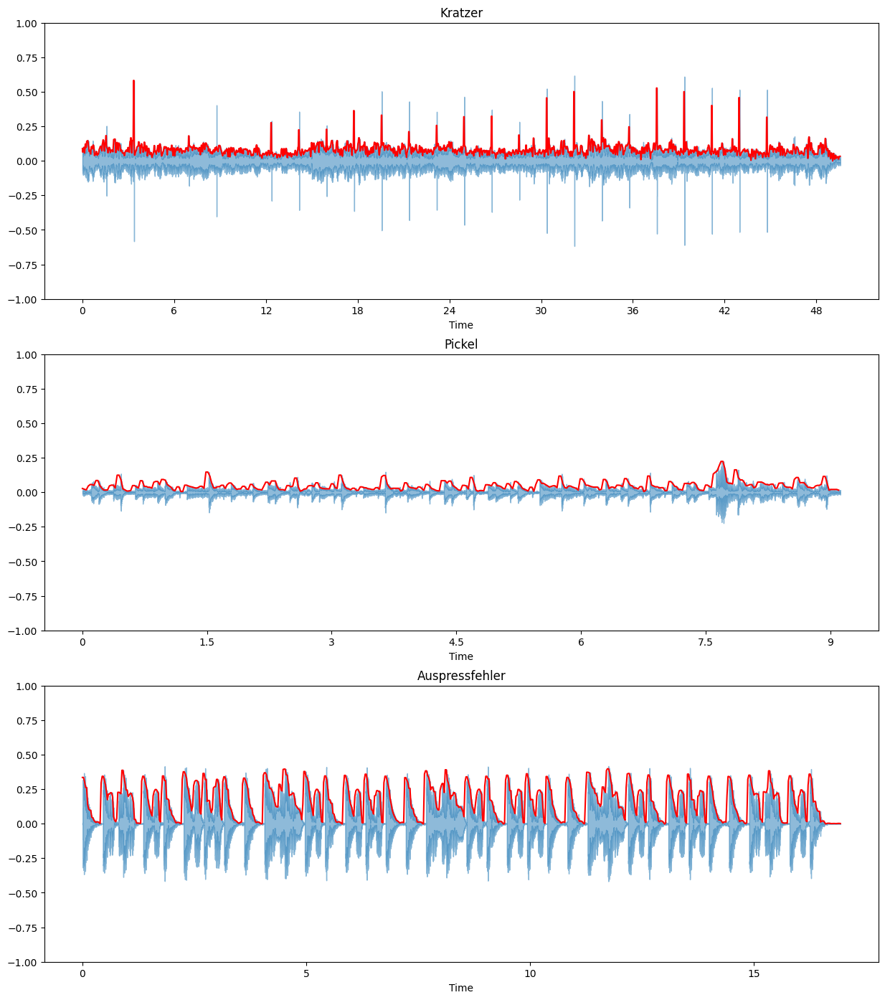

In [67]:
#  visualize amplitude envelope

# frames = range(0, ae_kratzer.size)
# t = librosa.frames_to_time(frames=frames, hop_length=HOP_LENGTH)

plt.figure(figsize=(15, 17))

plt.subplot(3, 1, 1)
librosa.display.waveshow(kratzer, alpha=0.5)
plt.plot(librosa.frames_to_time(frames=range(0, ae_kratzer.size), hop_length=HOP_LENGTH), ae_kratzer, color="r")
plt.title("Kratzer")
plt.ylim(-1, 1)

plt.subplot(3, 1, 2)
librosa.display.waveshow(pickel, alpha=0.5)
plt.plot(librosa.frames_to_time(frames=range(0, ae_pickel.size), hop_length=HOP_LENGTH), ae_pickel, color="r")
plt.title("Pickel")
plt.ylim(-1, 1)

plt.subplot(3, 1, 3)
librosa.display.waveshow(auspressfehler, alpha=0.5)
plt.plot(librosa.frames_to_time(frames=range(0, ae_auspressfehler.size), hop_length=HOP_LENGTH), ae_auspressfehler, color="r")
plt.title("Auspressfehler")
plt.ylim(-1, 1)
